# **Data Preparation**

In [1]:
%matplotlib inline
import warnings
warnings.filterwarnings("ignore")
from ipywidgets import FloatProgress

import os
import pathlib
from matplotlib import pyplot as plt
import seaborn as sns
import pickle
import pandas as pd
import numpy as np
import cv2
import skimage
from skimage.util import random_noise
import tensorflow as tf

from tqdm.notebook import tqdm
import random

In [2]:
print(os.listdir())

['(Baseline)_REDNet_256x256.ipynb', '.ipynb_checkpoints', 'best_REDNet_blindnoise_256x256.h5', 'best_REDNet_blindnoise_256x256.keras', 'GT', 'GT_test', 'IMG_20220323_221544.jpg', 'MWCNN_256x256.ipynb', 'NIND_7D-3_ISO100.png', 'Noise_image36.png', 'PRIDNet_256x256.ipynb', 'PXL_20231109_174742844.png', 'SIDD_custom_test', 'SIDD_Small_sRGB_Only', 'test']


In [24]:
def get_images_paths(root_dir_ssid):
    # Getting SSID dataset images
    root = pathlib.Path(root_dir_ssid)
    img_paths = list(root.rglob("*.PNG*"))
    img_paths_lst = [str(path) for path in img_paths]

    gt_lst = []
    noisy_lst= []
    
    for p in img_paths_lst:
        if "NOISY" in p and "checkpoints" not in p:
            noisy_lst.append(p)
        elif "GT" in p and "checkpoints" not in p:
            gt_lst.append(p)
            
    noisy_array = np.asarray(noisy_lst)
    gt_array = np.asarray(gt_lst)
    return noisy_array, gt_array


In [25]:
from sklearn.model_selection import train_test_split

noisy_array_paths, gt_array_paths = get_images_paths("SIDD_Small_sRGB_Only/Data")

print(len(noisy_array_paths))
print(len(gt_array_paths))
noisy_train_paths, noisy_test_paths, gt_train_paths, gt_test_paths = train_test_split(noisy_array_paths, gt_array_paths, test_size=0.20, random_state=42)

50
50


In [48]:
n_paths, gt_paths = get_images_paths("SIDD_custom_test")
print(n_paths,gt_paths)

['SIDD_custom_test\\1\\NOISY_1.png' 'SIDD_custom_test\\10\\NOISY_10.png'
 'SIDD_custom_test\\2\\NOISY_2.png' 'SIDD_custom_test\\3\\NOISY_3.png'
 'SIDD_custom_test\\4\\NOISY_4.png' 'SIDD_custom_test\\5\\NOISY_5.png'
 'SIDD_custom_test\\50\\NOISY_50.png' 'SIDD_custom_test\\6\\NOISY_6.png'
 'SIDD_custom_test\\7\\NOISY_7.png' 'SIDD_custom_test\\8\\NOISY_8.png'
 'SIDD_custom_test\\9\\NOISY_9.png' 'SIDD_custom_test\\90\\NOISY_90.png'] ['SIDD_custom_test\\1\\GT_1.png' 'SIDD_custom_test\\10\\GT_10.png'
 'SIDD_custom_test\\2\\GT_2.png' 'SIDD_custom_test\\3\\GT_3.png'
 'SIDD_custom_test\\4\\GT_4.png' 'SIDD_custom_test\\5\\GT_5.png'
 'SIDD_custom_test\\50\\GT_50.png' 'SIDD_custom_test\\6\\GT_6.png'
 'SIDD_custom_test\\7\\GT_7.png' 'SIDD_custom_test\\8\\GT_8.png'
 'SIDD_custom_test\\9\\GT_9.png' 'SIDD_custom_test\\90\\GT_90.png']


In [27]:
print(noisy_train_paths.shape)
print(noisy_test_paths.shape)
print(gt_train_paths.shape)
print(gt_test_paths.shape)

(40,)
(10,)
(40,)
(10,)


In [87]:
# Get gt_images in memory
"""
def get_images_in_mem(images_paths):
    images_lst = []
    for img_path in tqdm(images_paths):
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, (256, 256))
        images_lst.append(img)
    return np.array(images_lst)
"""

In [28]:
import cv2
import numpy as np
from tqdm import tqdm

def get_images_in_mem(images_paths, target_size=(256, 256)):
    """
    Loads images from specified paths, converts to RGB, resizes, and stores them in a numpy array.

    Args:
    images_paths (list of str): List of image file paths.
    target_size (tuple of int): Desired size (width, height) of the output images.

    Returns:
    numpy.ndarray: Array of processed images.
    """
    images_lst = []
    for img_path in tqdm(images_paths, desc="Loading images"):
        # Try to read and process each image
        try:
            img = cv2.imread(img_path)
            if img is not None:
                img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
                img = cv2.resize(img, target_size)
                images_lst.append(img)
            else:
                print(f"Warning: Failed to read image at {img_path}. It may be corrupted or in an unsupported format.")
        except Exception as e:
            print(f"Error processing {img_path}: {e}")

    return np.array(images_lst)

# Example usage:
# image_paths = ['path/to/image1.jpg', 'path/to/image2.jpg']
# images = get_images_in_mem(image_paths)


In [14]:
noisy_train_images = get_images_in_mem(noisy_train_paths)
noisy_test_images = get_images_in_mem(noisy_test_paths)

gt_train_images = get_images_in_mem(gt_train_paths)
gt_test_images = get_images_in_mem(gt_test_paths)

print(noisy_train_images.shape)
print(noisy_test_images.shape)

print(gt_train_images.shape)
print(gt_test_images.shape)

Loading images: 100%|██████████████████████████████████████████████████████████████████| 10/10 [00:02<00:00,  4.17it/s]

(40, 256, 256, 3)
(10, 256, 256, 3)
(40, 256, 256, 3)
(10, 256, 256, 3)


In [49]:
n_t_images = get_images_in_mem(n_paths)
gt_t_images = get_images_in_mem(gt_paths)


Loading images: 100%|██████████████████████████████████████████████████████████████████| 12/12 [00:01<00:00,  7.79it/s]


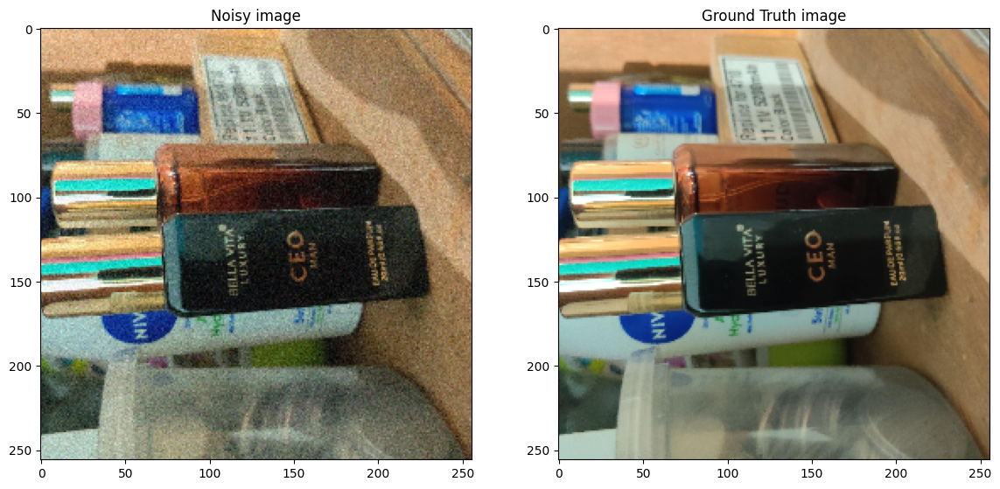

In [30]:
f, axarr = plt.subplots(1,2, figsize=(14,14))
axarr[0].imshow(n_t_images[5])
axarr[0].set_title("Noisy image")
axarr[1].imshow(gt_t_images[5])
axarr[1].title.set_text("Ground Truth image")

In [31]:
def _up_down_flip(image, label):
    image = tf.image.flip_up_down(image)
    label = tf.image.flip_up_down(label)
    return image, label

def _left_right_flip(image, label):
    image = tf.image.flip_left_right(image)
    label = tf.image.flip_left_right(label)
    return image, label

def _rotate(image, label):
    random_angle = tf.random.uniform(shape=[], minval=0, maxval=4, dtype=tf.int32)
    image = tf.image.rot90(image, random_angle)
    label = tf.image.rot90(label, random_angle)
    return image, label

def _hue(image, label):
    rand_value = random.uniform(-1,1)
    image = tf.image.adjust_hue(image, rand_value)
    label = tf.image.adjust_hue(label, rand_value)
    return image, label

def _brightness(image, label):
    rand_value = random.uniform(-0.08,0.25)
    image = tf.image.adjust_brightness(image, rand_value)
    label = tf.image.adjust_brightness(label, rand_value)
    return image, label

def _saturation(image, label):
    rand_value = random.uniform(1, 5)
    image = tf.image.adjust_saturation(image, rand_value)
    label = tf.image.adjust_saturation(label, rand_value)
    return image, label

def _contrast(image, label):
    rand_value = random.uniform(1, 3)
    image = tf.image.adjust_contrast(image, rand_value)
    label = tf.image.adjust_contrast(label, rand_value)
    return image, label

# What does batch, repeat, and shuffle do with TensorFlow Dataset?
# https://stackoverflow.com/q/53514495/7697658
def tf_data_generator(X, y, batch_size=32, augmentations=None):
    dataset = tf.data.Dataset.from_tensor_slices((X, y)) # This is the main step for data generation
    dataset = dataset.shuffle(1000, reshuffle_each_iteration=True)

    if augmentations:
        for f in augmentations:
            if np.random.uniform(0,1)<0.5:
                dataset = dataset.map(f, num_parallel_calls=2)

    dataset = dataset.repeat()
    dataset = dataset.batch(batch_size=batch_size, drop_remainder=True)
    dataset = dataset.prefetch(tf.data.experimental.AUTOTUNE)
    return dataset

BATCH_SIZE=4
augmentation_lst = [_up_down_flip, _left_right_flip, _rotate]
image_generator_train = tf_data_generator(X=noisy_train_images, y=gt_train_images, batch_size=BATCH_SIZE, augmentations=augmentation_lst)
image_generator_test = tf_data_generator(X=noisy_test_images, y=gt_test_images, batch_size=BATCH_SIZE)

In [32]:
image_generator_train

<_PrefetchDataset element_spec=(TensorSpec(shape=(4, 256, 256, 3), dtype=tf.uint8, name=None), TensorSpec(shape=(4, 256, 256, 3), dtype=tf.uint8, name=None))>

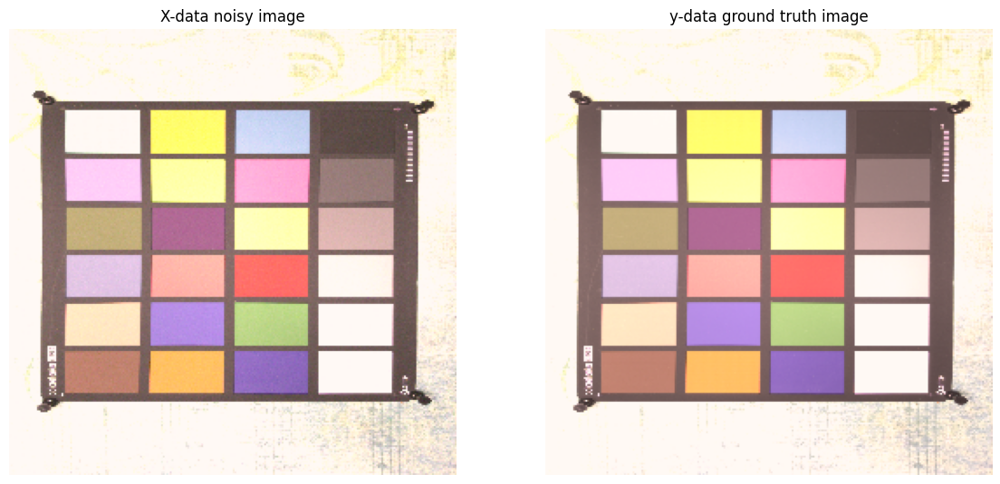

In [33]:
# SANITY CHECK of the Dataset generator
for noisy, gt in image_generator_train.take(1):  # only take first element of dataset
    numpy_images = noisy.numpy()
    numpy_labels = gt.numpy()

f, axarr = plt.subplots(1,2, figsize=(14,14))
axarr[0].imshow(numpy_images[1])
axarr[0].set_title("X-data noisy image")
axarr[0].set_axis_off()

axarr[1].imshow(numpy_labels[1])
axarr[1].set_title("y-data ground truth image")
axarr[1].set_axis_off()

# **CNN Auto Encoder (Baseline model)**
<a href="https://arxiv.org/pdf/1606.08921.pdf">https://arxiv.org/pdf/1606.08921.pdf</a>


In [40]:
import tensorflow as tf
from tensorflow.keras import models, layers
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Conv2D, Conv2DTranspose, BatchNormalization, Activation, Flatten, Dense, Input, Add
from tensorflow.keras import initializers, regularizers
from tensorflow.keras.optimizers import Adam

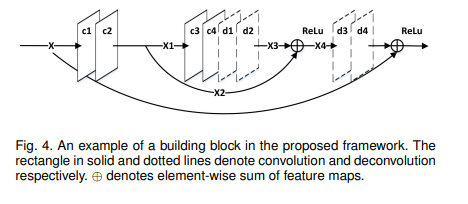

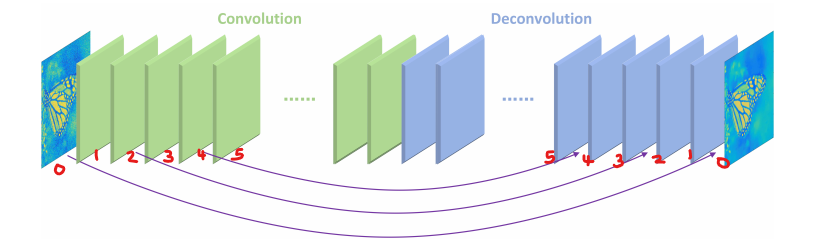

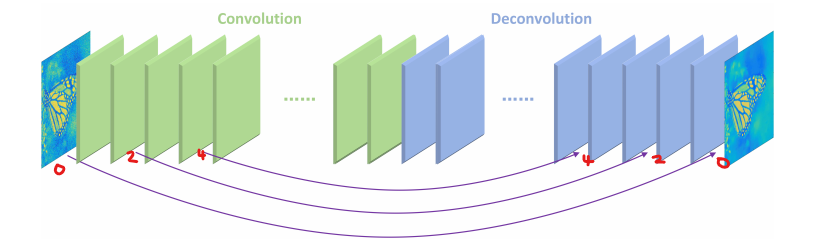

In [41]:
def create_model():
    tf.keras.backend.clear_session()

    input_0 = Input(shape=(256,256,3), name="input_layer")
    conv_layer_1 = Conv2D(filters=256, kernel_size=2, padding='same', name="conv_1")(input_0)
    conv_layer_2 = Conv2D(filters=256, kernel_size=2, padding='same', name="conv_2")(conv_layer_1)
    conv_layer_3 = Conv2D(filters=256, kernel_size=3, padding='same', name="conv_3")(conv_layer_2)
    conv_layer_4 = Conv2D(filters=256, kernel_size=3, padding='same', name="conv_4")(conv_layer_3)
    conv_layer_5 = Conv2D(filters=128, kernel_size=3, padding='same', name="conv_5")(conv_layer_4)

    deconv_layer_5 = Conv2DTranspose(filters=256, kernel_size=2, padding='same', name="deconv_5")(conv_layer_5)
    deconv_layer_5 = Add(name="add_1")([conv_layer_4, deconv_layer_5])
    deconv_layer_4 = Conv2DTranspose(filters=256, kernel_size=2, padding='same', name="deconv_4")(deconv_layer_5)
    deconv_layer_3 = Conv2DTranspose(filters=256, kernel_size=3, padding='same', name="deconv_3")(deconv_layer_4)
    deconv_layer_3 = Add(name="add_2")([conv_layer_2, deconv_layer_3])
    deconv_layer_2 = Conv2DTranspose(filters=128, kernel_size=3, padding='same', name="deconv_2")(deconv_layer_3)
    deconv_layer_1 = Conv2DTranspose(filters=3, kernel_size=3, padding='same', name="deconv_1")(deconv_layer_2)
    out = Add(name="add_3")([input_0, deconv_layer_1])

    model = Model(inputs=[input_0], outputs=[out])
    return model

In [42]:
model = create_model()
model.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                  ┃ Output Shape              ┃         Param # ┃ Connected to               ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)      │ (None, 256, 256, 3)       │               0 │ -                          │
├───────────────────────────────┼───────────────────────────┼─────────────────┼────────────────────────────┤
│ conv_1 (Conv2D)               │ (None, 256, 256, 256)     │           3,328 │ input_layer[0][0]          │
├───────────────────────────────┼───────────────────────────┼─────────────────┼────────────────────────────┤
│ conv_2 (Conv2D)               │ (None, 256, 256, 256)     │         262,400 │ conv_1[0][0]               │
├───────────────────────────────┼───────────────────────────┼─────────────────┼────────────────────────────┤
│ conv_3 (Conv2D)               │ (None, 256, 256, 256)     │         590,080 │ conv_2[0][0]               │
├───────────────────────────────┼───────────────────────────┼─────────────────┼────────────────────────────┤
│ conv_4 (Conv2D)               │ (None, 256, 256, 256)     │         590,080 │ conv_3[0][0]               │
├───────────────────────────────┼───────────────────────────┼─────────────────┼────────────────────────────┤
│ conv_5 (Conv2D)               │ (None, 256, 256, 128)     │         295,040 │ conv_4[0][0]               │
├───────────────────────────────┼───────────────────────────┼─────────────────┼────────────────────────────┤
│ deconv_5 (Conv2DTranspose)    │ (None, 256, 256, 256)     │         131,328 │ conv_5[0][0]               │
├───────────────────────────────┼───────────────────────────┼─────────────────┼────────────────────────────┤
│ add_1 (Add)                   │ (None, 256, 256, 256)     │               0 │ conv_4[0][0],              │
│                               │                           │                 │ deconv_5[0][0]             │
├───────────────────────────────┼───────────────────────────┼─────────────────┼────────────────────────────┤
│ deconv_4 (Conv2DTranspose)    │ (None, 256, 256, 256)     │         262,400 │ add_1[0][0]                │
├───────────────────────────────┼───────────────────────────┼─────────────────┼────────────────────────────┤
│ deconv_3 (Conv2DTranspose)    │ (None, 256, 256, 256)     │         590,080 │ deconv_4[0][0]             │
├───────────────────────────────┼───────────────────────────┼─────────────────┼────────────────────────────┤
│ add_2 (Add)                   │ (None, 256, 256, 256)     │               0 │ conv_2[0][0],              │
│                               │                           │                 │ deconv_3[0][0]             │
├───────────────────────────────┼───────────────────────────┼─────────────────┼────────────────────────────┤
│ deconv_2 (Conv2DTranspose)    │ (None, 256, 256, 128)     │         295,040 │ add_2[0][0]                │
├───────────────────────────────┼───────────────────────────┼─────────────────┼────────────────────────────┤
│ deconv_1 (Conv2DTranspose)    │ (None, 256, 256, 3)       │           3,459 │ deconv_2[0][0]             │
├───────────────────────────────┼───────────────────────────┼─────────────────┼────────────────────────────┤
│ add_3 (Add)                   │ (None, 256, 256, 3)       │               0 │ input_layer[0][0],         │
│                               │                           │                 │ deconv_1[0][0]             │
└───────────────────────────────┴───────────────────────────┴─────────────────┴────────────────────────────┘

 Total params: 3,023,235 (11.53 MB)

 Trainable params: 3,023,235 (11.53 MB)

 Non-trainable params: 0 (0.00 B)

In [44]:
tf.keras.utils.plot_model(model=model, to_file='model_plot.png', show_shapes=True)

You must install pydot (`pip install pydot`) for `plot_model` to work.


# **Training**

In [45]:
steps_per_epoch_train = len(noisy_train_images)
steps_per_epoch_validation = len(noisy_test_images)

In [46]:
#best_models_path = "/content/drive/MyDrive/Colab Notebooks/Applied AI Assignments/Case Study 2 Image Denoising/Best Models/baseline model/"
callbacks_lst = [
    tf.keras.callbacks.ModelCheckpoint(filepath="best_REDNet_blindnoise_256x256.keras", save_weights_only=False),
    tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', min_lr=0.000009, min_delta=0.0001, factor=0.75, patience=3, verbose=1, mode='min'),
    tf.keras.callbacks.EarlyStopping(monitor='val_loss', mode='min', verbose=1, min_delta=0.0001, patience=10)
]

In [47]:
model.compile(loss=tf.keras.losses.MeanSquaredError(), optimizer=Adam(learning_rate=0.0001))
model.fit(image_generator_train, 
          validation_data=image_generator_test,
                        steps_per_epoch=steps_per_epoch_train,
                        validation_steps=steps_per_epoch_validation,
                        epochs=10,
                        verbose=1,
                        callbacks=callbacks_lst)

Epoch 1/10
40/40 ━━━━━━━━━━━━━━━━━━━━ 1050s 26s/step - loss: 3837.5583 - val_loss: 282.3286 - learning_rate: 1.0000e-04
Epoch 2/10
40/40 ━━━━━━━━━━━━━━━━━━━━ 1044s 26s/step - loss: 148.1030 - val_loss: 177.8403 - learning_rate: 1.0000e-04
Epoch 3/10
40/40 ━━━━━━━━━━━━━━━━━━━━ 1038s 26s/step - loss: 97.1561 - val_loss: 139.7073 - learning_rate: 1.0000e-04
Epoch 4/10
40/40 ━━━━━━━━━━━━━━━━━━━━ 1030s 26s/step - loss: 79.8975 - val_loss: 117.6349 - learning_rate: 1.0000e-04
Epoch 5/10
40/40 ━━━━━━━━━━━━━━━━━━━━ 1140s 29s/step - loss: 75.2937 - val_loss: 113.2285 - learning_rate: 1.0000e-04
Epoch 6/10
40/40 ━━━━━━━━━━━━━━━━━━━━ 1103s 28s/step - loss: 62.5866 - val_loss: 99.8081 - learning_rate: 1.0000e-04
Epoch 7/10
40/40 ━━━━━━━━━━━━━━━━━━━━ 1216s 30s/step - loss: 61.0715 - val_loss: 99.1753 - learning_rate: 1.0000e-04
Epoch 8/10
40/40 ━━━━━━━━━━━━━━━━━━━━ 1084s 27s/step - loss: 60.4413 - val_loss: 98.7862 - learning_rate: 1.0000e-04
Epoch 9/10
40/40 ━━━━━━━━━━━━━━━━━━━━ 1096s 27s/step - l

gt_images are in range of 0-255 (int);<br>
noisy_images are in range of 0-255 (int);<br>
predicted_images are in range 0-255 (float);

In [49]:
model.save("best_REDNet_blindnoise_256x256.keras")

# **Inference**

In [34]:
# Inference
def inference_single_image(model, noisy_image):
    input_image = np.expand_dims(noisy_image, axis=0)
    predicted_image = model.predict(input_image)
    
    return predicted_image[0]

In [35]:
def inference_batch_images(model, noisy_images):
    predicted_image = model.predict(noisy_images, batch_size=4)
    return predicted_image

In [36]:
def visualize_predictions(model, X_test, y_test, n):
    random_numbers = random.choices(range(X_test.shape[0]), k=n)    # Get n random indices
    for i in random_numbers:
        noisy_image = X_test[i]
        gt_image = y_test[i]
        predicted_image = inference_single_image(model, X_test[i])
        predicted_image/=255

        f, axarr = plt.subplots(1,3, figsize=(21,21))
        axarr[0].imshow(noisy_image)
        axarr[0].set_title("Noisy image")
        axarr[0].set_axis_off()
        axarr[1].imshow(gt_image)
        axarr[1].set_title("Ground truth image")
        axarr[1].set_axis_off()
        axarr[2].imshow(predicted_image)
        axarr[2].set_title("Predicted image")
        axarr[2].set_axis_off()

In [37]:
model = tf.keras.models.load_model('best_REDNet_blindnoise_256x256.keras')

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


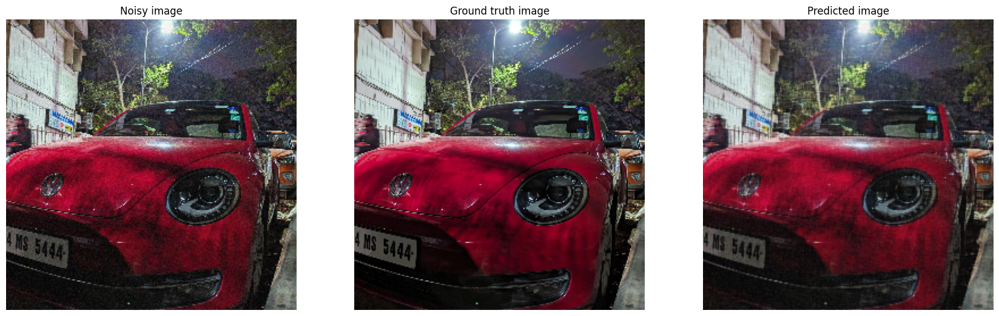

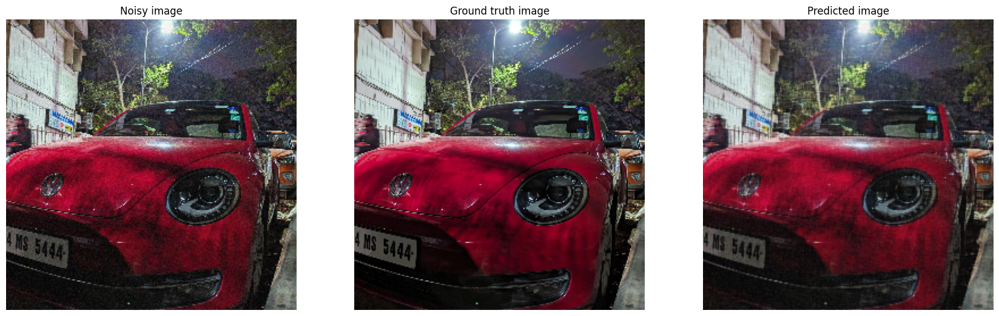

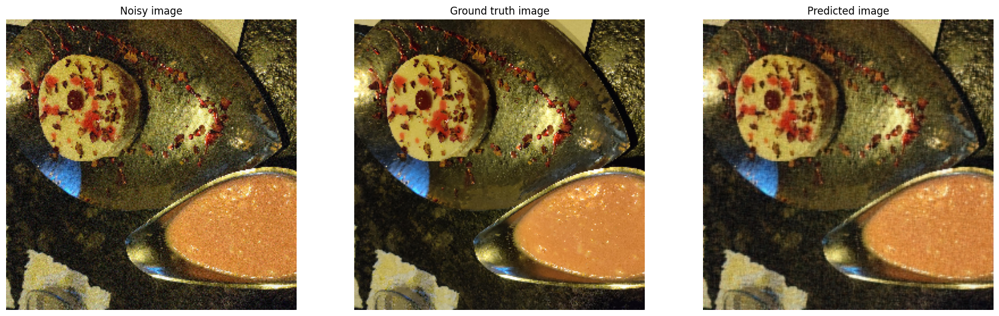

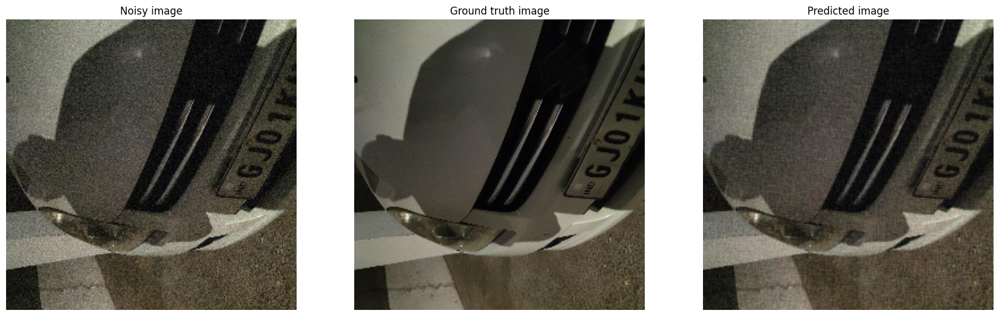

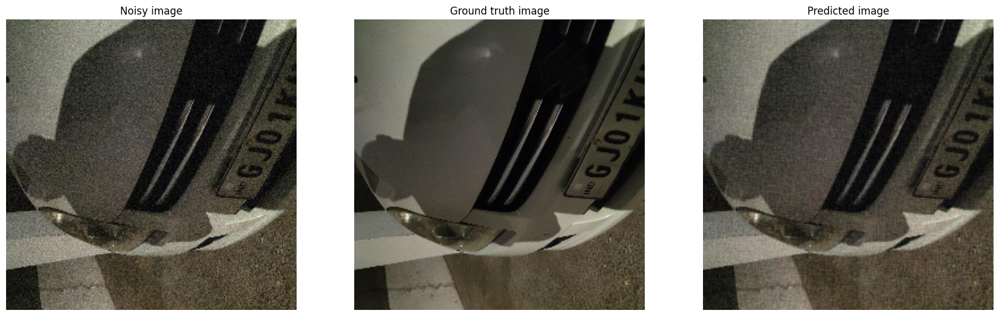

...

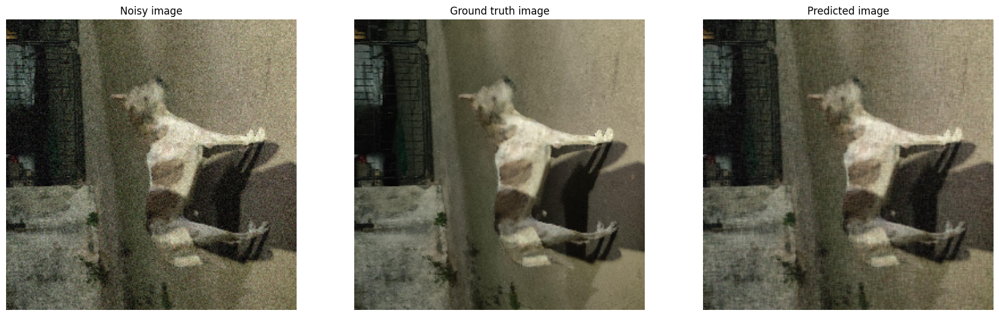

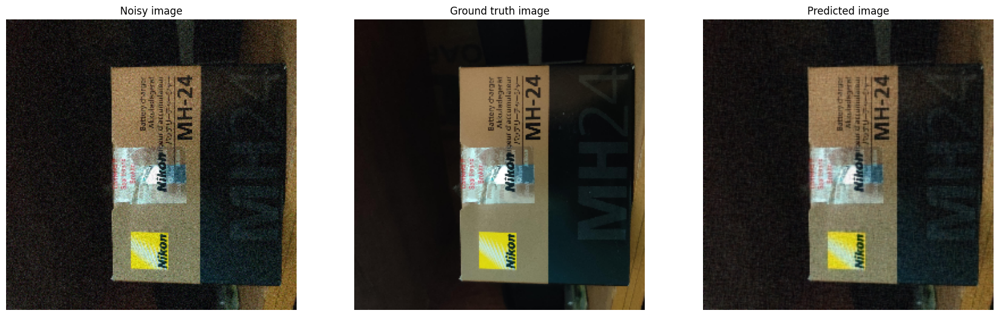

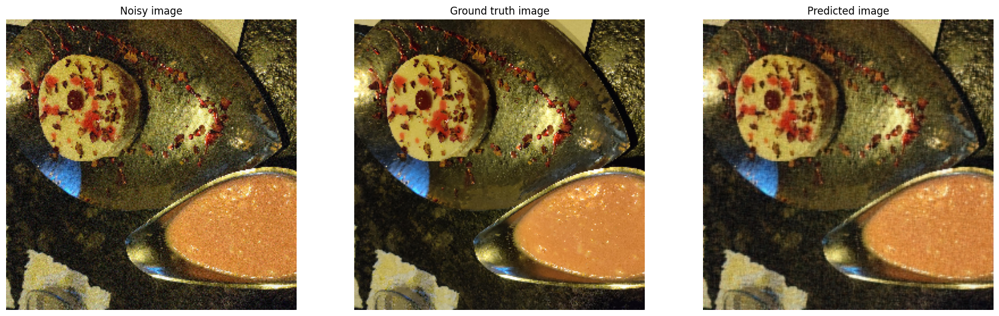

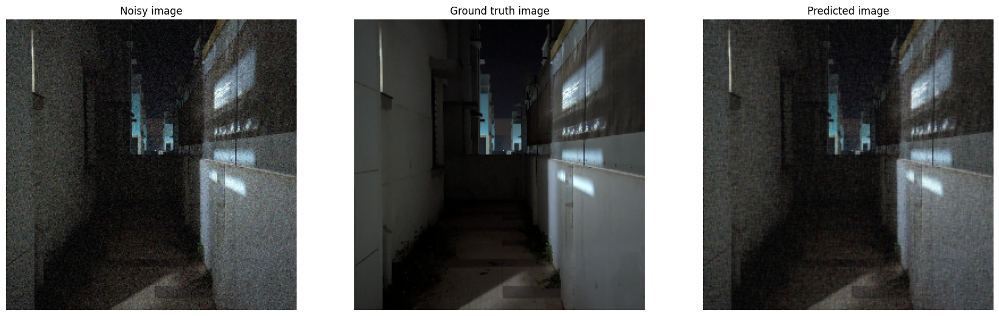

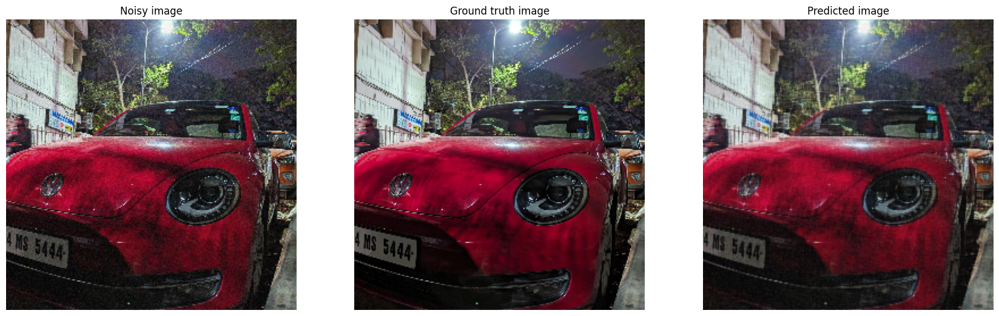

In [50]:
visualize_predictions(model, n_t_images, gt_t_images, 12)

In [ ]:
# # Download 5 of the images pairs and predictions
# for i in range(5):
#     im_rgb = cv2.cvtColor(gt_test_images[i], cv2.COLOR_BGR2RGB)
#     cv2.imwrite(str(i)+'_gt.jpg', im_rgb)

#     im_rgb = cv2.cvtColor(noisy_test_images[i], cv2.COLOR_BGR2RGB)
#     cv2.imwrite(str(i)+'_noisy.jpg', im_rgb)

#     predicted_image = inference_single_image(model, im_rgb).astype(np.uint8)
#     cv2.imwrite(str(i)+'_predicted.jpg', predicted_image)

# !mkdir download
# !mv -t download *.jpg
# !zip -r temp.zip download
# !rm -r download

In [41]:
# Test image prediction
banana = "NIND_banana_ISOH3.png"
kibbles = "NIND_kibbles_ISOH3.png"
library = "NIND_BruegelLibraryS1_NZ.png"
parrots = "kodim23-noise-std51.png"
eye = "eye_closeup_smaller_DIM25_noise_stddev_51.png"
stars = "Noise_image36.png"

img_path = "IPCV/Github/Image-Denoising-using-Deep-Learning/Models/SIDD_custom_test/6/NOISY_6.png"

img = cv2.imread(img_path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img = cv2.resize(img, (256, 256))

predicted_image = inference_single_image(model, img)
predicted_image/=255

f, axarr = plt.subplots(1,2, figsize=(14,14))
axarr[0].imshow(img)
axarr[0].title.set_text("Noisy image")
axarr[0].set_axis_off()
axarr[1].imshow(predicted_image)
axarr[1].title.set_text("Predicted image")
axarr[1].set_axis_off()
axarr[1].imshow(predicted_image)
axarr[1].title.set_text("Predicted image")
axarr[1].set_axis_off()

error: OpenCV(4.9.0) D:\a\opencv-python\opencv-python\opencv\modules\imgproc\src\color.cpp:196: error: (-215:Assertion failed) !_src.empty() in function 'cv::cvtColor'


In [42]:
from skimage.metrics import peak_signal_noise_ratio

predicted_images = inference_batch_images(model, noisy_test_images)
psnr_original_mean = 0
psnr_prediction_mean = 0

for gt_img, noisy_img, predicted_img in zip(gt_test_images, noisy_test_images, predicted_images):
    psnr_original_mean += peak_signal_noise_ratio(gt_img, noisy_img)
    psnr_prediction_mean += peak_signal_noise_ratio(gt_img, predicted_img)

psnr_original_mean/=gt_test_images.shape[0]
psnr_prediction_mean/=gt_test_images.shape[0]
print("Original average gt-noisy PSNR ->", psnr_original_mean)
print("Predicted average gt-predicted PSNR ->", psnr_prediction_mean)

3/3 ━━━━━━━━━━━━━━━━━━━━ 9s 3s/step
Original average gt-noisy PSNR -> 27.938678905741703
Predicted average gt-predicted PSNR -> 31.596448508474122


In [43]:
from skimage.metrics import structural_similarity as ssim

predicted_images = inference_batch_images(model, noisy_test_images)
ssim_original_mean = 0
ssim_prediction_mean = 0

for gt_img, noisy_img, predicted_img in zip(gt_test_images, noisy_test_images, predicted_images):
    ssim_original_mean += ssim(gt_img, noisy_img, multichannel=True, data_range=noisy_img.max() - noisy_img.min())
    ssim_prediction_mean += ssim(gt_img, predicted_img, multichannel=True, data_range=predicted_img.max() - predicted_img.min())

ssim_original_mean/=gt_test_images.shape[0]
ssim_prediction_mean/=gt_test_images.shape[0]
print("Original average gt-noisy SSIM ->", ssim_original_mean)
print("Predicted average gt-predicted SSIM ->", ssim_prediction_mean)

3/3 ━━━━━━━━━━━━━━━━━━━━ 22s 7s/step


ValueError: win_size exceeds image extent. Either ensure that your images are at least 7x7; or pass win_size explicitly in the function call, with an odd value less than or equal to the smaller side of your images. If your images are multichannel (with color channels), set channel_axis to the axis number corresponding to the channels.

In [53]:
from prettytable import PrettyTable

pt = PrettyTable()
pt.field_names = ["Model", "PSNR", "SSIM", "PSNR Improvement", "SSIM improvement"]

pt.add_row(["Original X-y pairs (No Model)","26.3779","0.6000", "-", "-"])
pt.add_row(["REDNet (Baseline)","30.5713","0.7932", "4.1934","0.1932"])
pt.add_row(["MWCNN (using Wavelets)","32.5220","0.8397","6.1441","0.2397"])

print(pt)

+-------------------------------+---------+--------+------------------+------------------+
|             Model             |   PSNR  |  SSIM  | PSNR Improvement | SSIM improvement |
+-------------------------------+---------+--------+------------------+------------------+
| Original X-y pairs (No Model) | 26.3779 | 0.6000 |        -         |        -         |
|       REDNet (Baseline)       | 30.5713 | 0.7932 |      4.1934      |      0.1932      |
|     MWCNN (using Wavelets)    | 32.5220 | 0.8397 |      6.1441      |      0.2397      |
+-------------------------------+---------+--------+------------------+------------------+
